In [ ]:
import cospar as cs
import pandas as pd
import scipy
import numpy as np
import os
import scanpy as sc
from cospar.plotting import _utils as pl_util

%reload_ext autoreload
%autoreload 2

import pandas as pd
import torch
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
cs.settings.set_figure_params(format="png", figsize=[4, 3.5], dpi=600, fontsize=12, pointsize=3)

### CoSpar Basics

In [ ]:
adata = sc.read_h5ad('./datasets/CordBlood_Refine/adata_update.h5ad')
adata

In [ ]:
adata.obs['meta_clones'] = adata.obs['Meta clones'].values
adata.obs['label_man'] = adata.obs['def_lab'].values
adata = adata[adata.obs['meta_clones'] != '-1.0', :]

In [ ]:
adata.obs['Clone_ID'] = [name[6:] for name in adata.obs.clones.values]

In [ ]:
adata.obs

In [ ]:
RNA_count_matrix = scipy.sparse.coo_matrix(np.expm1(adata.raw.X))

In [ ]:
adata_orig = cs.pp.initialize_adata_object(
    X_state=RNA_count_matrix,
    gene_names=adata.raw.var_names,
    cell_names=adata.obs.index,
    time_info=adata.obs.Timepoint.values,
    state_info=adata.obs.def_lab.values,
    X_emb=adata.obsm['X_umap'],
    X_pca=adata.obsm['X_pca'],
    data_des="cospar_cordblood",
)

In [ ]:
adata_orig.obs

In [ ]:
cs.hf.update_time_ordering(adata_orig, updated_ordering=["Day3", "Day10", "Day17"])

In [ ]:
cs.pp.get_highly_variable_genes(adata_orig)
cs.pp.remove_cell_cycle_correlated_genes(adata_orig, corr_threshold=0.5, confirm_change=True)
cs.pp.get_X_clone(adata_orig, adata.obs.index.values, adata.obs.Clone_ID.values)

In [ ]:
cs.pl.clones_on_manifold(
    adata_orig,
    selected_clone_list=[1],
    color_list=["black", "red", "blue"],
    clone_markersize=8,
)

In [ ]:
selected_fates = ["Late Erythroid", "Monocyte", "DC", "Mast cell"]

In [ ]:
cs.pl.barcode_heatmap(
    adata_orig,
    selected_fates=selected_fates,
    color_bar=True,
    log_transform=False,
    fig_height=5,
    fig_width=4
)

In [ ]:
cs.pl.barcode_heatmap(
    adata_orig,
    selected_fates=selected_fates,
    color_bar=True,
    log_transform=False,
    binarize=True,
    fig_height=4
)

In [ ]:
cs.tl.fate_coupling(adata_orig, selected_fates=selected_fates, source="X_clone") 
cs.pl.fate_coupling(adata_orig, source="X_clone")

Strong coupling implies the existence of bi-potent or multi-potent cell states at the time of barcoding. You can visualize the fate hierarchy by a simple neighbor-joining method

In [ ]:
cs.tl.fate_hierarchy(adata_orig, selected_fates=selected_fates, source="X_clone")
cs.pl.fate_hierarchy(adata_orig, source="X_clone")

In [ ]:
sc.pl.umap(adata, color="def_lab", groups='DC')

In [ ]:
df_results = []

for fate in selected_fates:
    cs.tl.clonal_fate_bias(adata_orig, selected_fate=fate, alternative="two-sided")
    cs.pl.clonal_fate_bias(adata_orig)
    df_results.append(adata_orig.uns["clonal_fate_bias"])

In [ ]:
for idx, fate in enumerate(selected_fates):
    df_results[idx].to_csv(f'./data/fate_bias_cordblood_cospar_{fate}.csv')

### Transition Map Inference

Smooth round: 17
--> Time elapsed: 51.59511160850525
--> Orignal sparsity=0.37248661276088274, Thresholding
--> Final sparsity=0.2847635661756825
similarity matrix truncated (Smooth round=17):  8.658657550811768
Smooth round: 18
--> Time elapsed: 7.652567625045776
--> Orignal sparsity=0.3832909698727812, Thresholding
--> Final sparsity=0.29435060077723035
similarity matrix truncated (Smooth round=18):  2.1452550888061523
Smooth round: 19
--> Time elapsed: 13.141818284988403
--> Orignal sparsity=0.393508603920972, Thresholding
--> Final sparsity=0.303538785905602
similarity matrix truncated (Smooth round=19):  3.6472818851470947
Smooth round: 20
--> Time elapsed: 13.486176013946533
--> Orignal sparsity=0.40317373537987616, Thresholding
--> Final sparsity=0.3123519345669892
similarity matrix truncated (Smooth round=20):  3.8130526542663574
--> Save the matrix at every 5 rounds


/ssd/users/mingzegao/.conda/envs/clonetrans/lib/python3.9/site-packages/cospar/tmap/map_reconstruction.py:237: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["data_des"] = [data_des_orig, data_des]


------Infer transition map between initial time points and the later time one------
--------Current initial time point: Day3--------
Step 1: Select time points
--> Clonal cell fraction (day Day3-Day17): 0.34557235421166305
--> Clonal cell fraction (day Day17-Day3): 0.24620132953466287
--> Numer of cells that are clonally related -- day Day3: 160  and day Day17: 2074
Number of multi-time clones post selection: 121


/ssd/users/mingzegao/.conda/envs/clonetrans/lib/python3.9/site-packages/cospar/tmap/_utils.py:390: ImplicitModificationWarning: Setting element `.obsm['X_clone']` of view, initializing view as actual.
  adata.obsm["X_clone"] = clone_annot


Cell number=8887, Clone number=121
--> clonal_cell_id_t1: 160
--> Tmap_cell_id_t1: 463
Step 2: Optimize the transition map recursively
Load pre-computed similarity matrix
--> Load from hard disk--------
--> Compute similarity matrix: load existing data
--> Time elapsed:  0.0018215179443359375
--> Time elapsed:  0.2647361755371094
--> Time elapsed:  0.004242658615112305
--> Time elapsed:  0.46425604820251465
--> Compute similarity matrix: load existing data
--> Time elapsed:  0.0016565322875976562
--> Time elapsed:  0.13644790649414062
--> Time elapsed:  0.003531217575073242
--> Time elapsed:  0.23505854606628418
--> Compute similarity matrix: load existing data
--> Time elapsed:  0.0012097358703613281
--> Time elapsed:  0.08722686767578125
--> Time elapsed:  0.002941131591796875
--> Time elapsed:  0.20433759689331055
--> Compute similarity matrix: load existing data
--> Time elapsed:  0.00084686279296875
--> Time elapsed:  0.07929825782775879
--> Time elapsed:  0.0016748905181884766
--

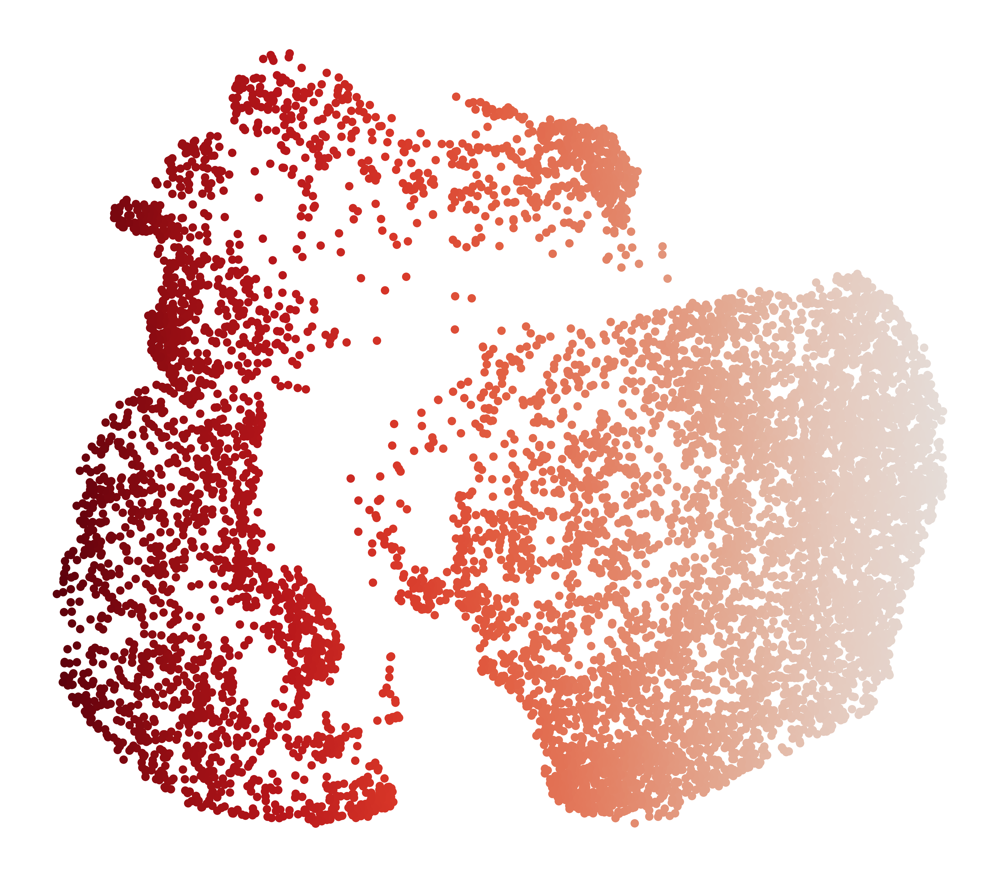

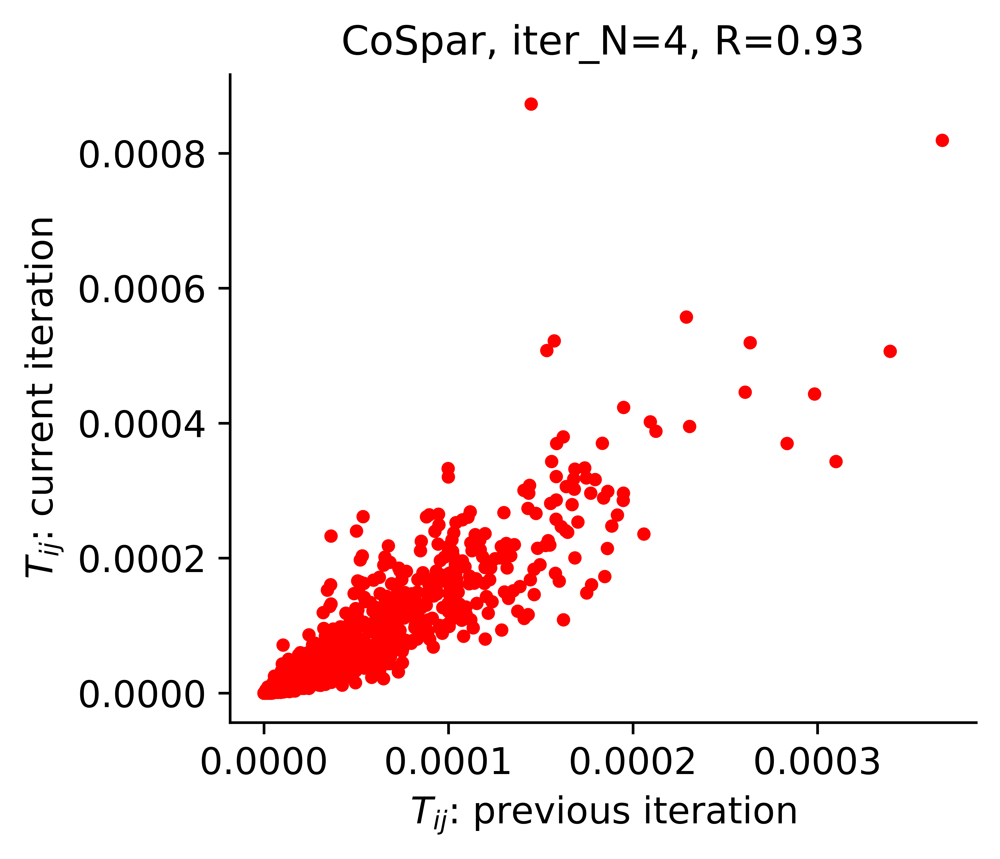

Iteration 5, Use smooth_round=5
--> Clone normalization
--> Relative time point pair index: 0
--> Clone id: 0
--> Start to smooth the refined clonal map
--> Phase I: time elapsed --  0.08964085578918457
--> Phase II: time elapsed --  0.0914919376373291


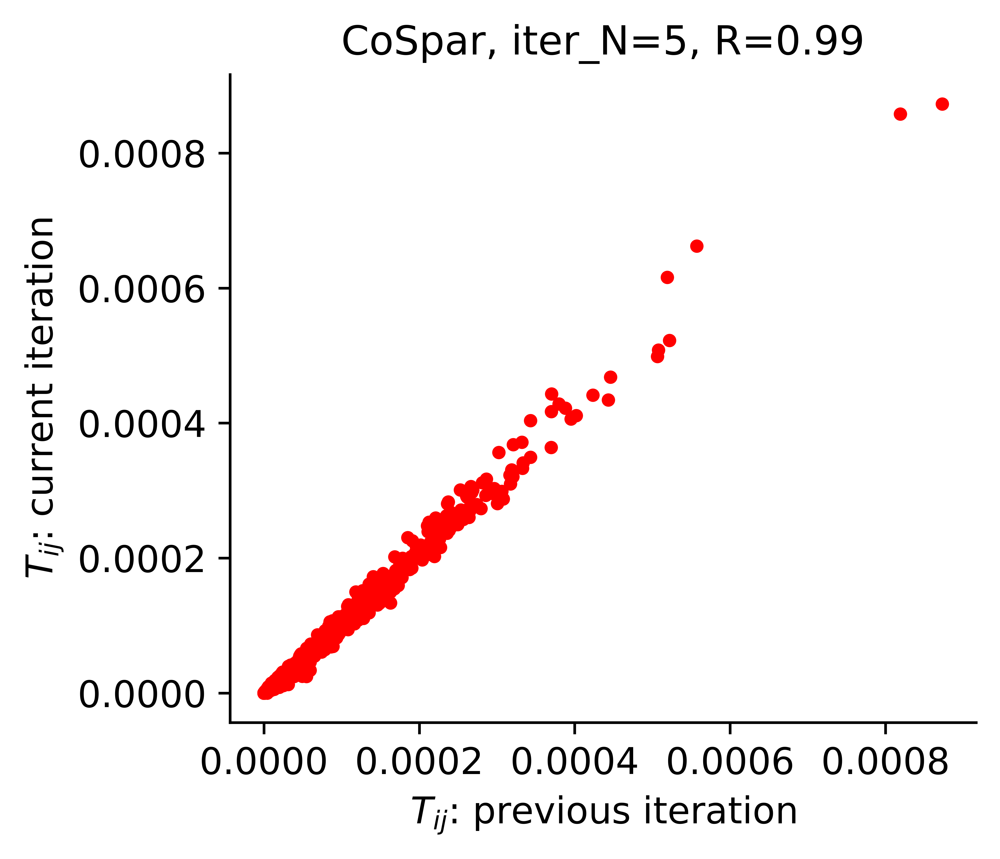

--> Final round of Smooth (to expand the state space of Tmap to include non-clonal states)
--> Phase I: time elapsed --  0.3882918357849121
--> Phase II: time elapsed --  0.4732542037963867
--> ----Intraclone transition map----
--> Clone normalization
--> Relative time point pair index: 0
--> Clone id: 0
--------Current initial time point: Day10--------
Step 1: Select time points
--> Clonal cell fraction (day Day10-Day17): 0.7473587505741847
--> Clonal cell fraction (day Day17-Day10): 0.85838081671415
--> Numer of cells that are clonally related -- day Day10: 1627  and day Day17: 7231
Number of multi-time clones post selection: 334
Cell number=10601, Clone number=334
--> clonal_cell_id_t1: 1627
--> Tmap_cell_id_t1: 2177
Step 2: Optimize the transition map recursively
Load pre-computed similarity matrix
--> Load from hard disk--------
--> Compute similarity matrix: load existing data
--> Time elapsed:  0.057237863540649414
--> Time elapsed:  1.4462862014770508
--> Time elapsed:  0.20946

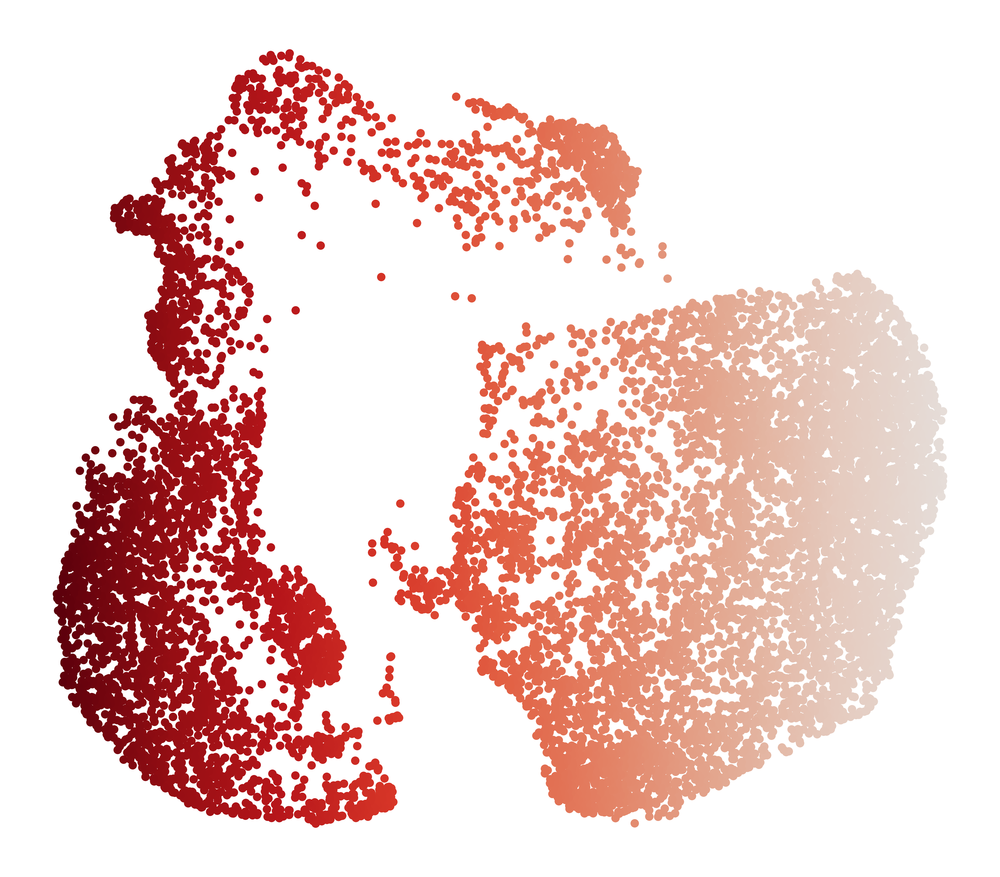

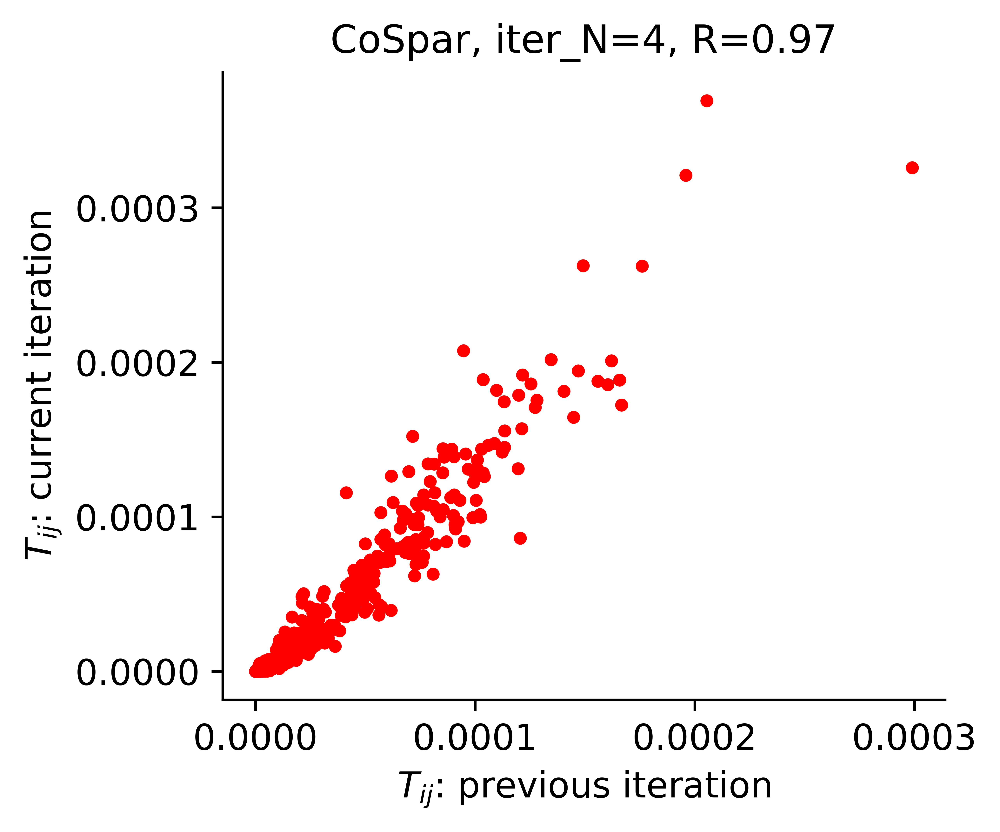

--> Final round of Smooth (to expand the state space of Tmap to include non-clonal states)
--> Phase I: time elapsed --  1.8593552112579346
--> Phase II: time elapsed --  2.184051275253296
--> ----Intraclone transition map----
--> Clone normalization
--> Relative time point pair index: 0
--> Clone id: 0
-----------Total used time: 511.5632357597351 s ------------


In [21]:
adata_all_latert = adata_orig.copy()
adata_all_latert = cs.tmap.infer_Tmap_from_multitime_clones(
    adata_all_latert,
    clonal_time_points=['Day3', 'Day10', 'Day17'],
    later_time_point='Day17',
    smooth_array=[20, 15, 10, 5],
    max_iter_N=10,
    compute_new=True
)

In [22]:
adata_all_latert

AnnData object with n_obs × n_vars = 11064 × 21924
    obs: 'time_info', 'state_info', 'n_counts'
    var: 'highly_variable'
    uns: 'data_des', 'time_ordering', 'clonal_time_points', 'clone_id', 'barcode_heatmap', 'available_map', 'fate_coupling_X_clone', 'fate_hierarchy_X_clone', 'clonal_fate_bias', 'neighbors', 'Tmap_cell_id_t1', 'Tmap_cell_id_t2', 'clonal_cell_id_t1', 'clonal_cell_id_t2', 'sp_idx', 'transition_map', 'intraclone_transition_map'
    obsm: 'X_clone', 'X_pca', 'X_emb'
    obsp: 'distances', 'connectivities'

### Transition Map Visualization

Results saved at adata.obs['fate_map_transition_map_Monocyte']
Results saved at adata.obs['fate_map_transition_map_DC']


/ssd/users/mingzegao/.conda/envs/clonetrans/lib/python3.9/site-packages/cospar/tool/_utils.py:235: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  state_annote[cell_id_t2] == yy


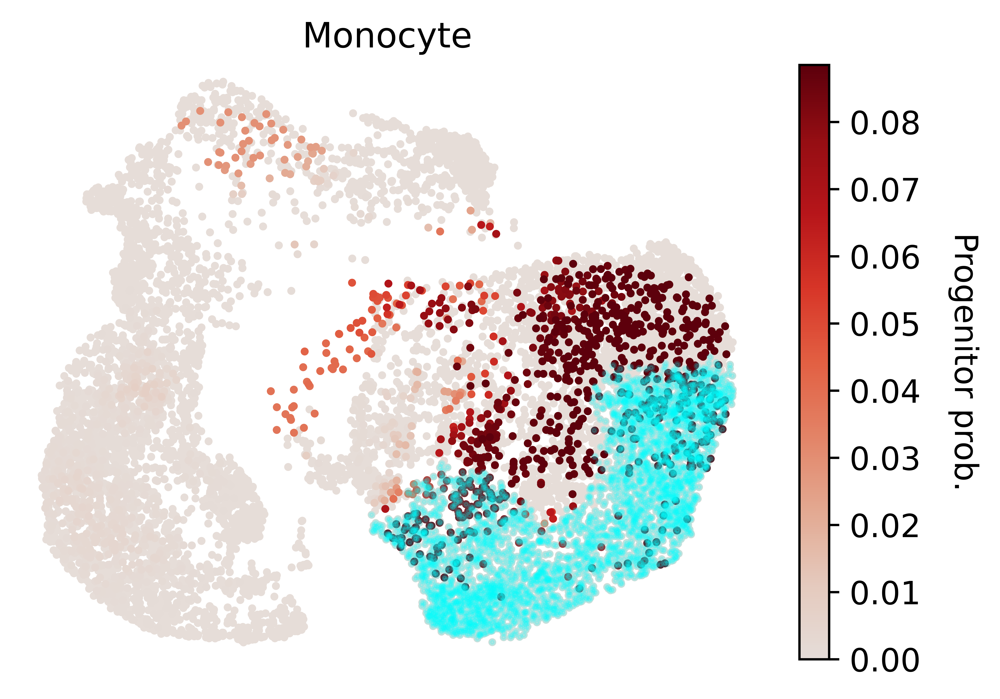

In [23]:
cs.tl.fate_map(
    adata_all_latert,
    selected_fates=["Monocyte", "DC"],
    source="transition_map",
    map_backward=True,
)

cs.pl.fate_map(
    adata_all_latert,
    selected_fates=["Monocyte"],
    source="transition_map",
    plot_target_state=True,
    show_histogram=False,
)

/ssd/users/mingzegao/.conda/envs/clonetrans/lib/python3.9/site-packages/cospar/tool/_utils.py:235: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  state_annote[cell_id_t2] == yy


Results saved at adata.obs['fate_map_transition_map_DC']
Results saved at adata.obs['fate_map_transition_map_HSC/MPP 2']
Results saved at adata.obs['fate_map_transition_map_DC precursor']
Results saved at adata.obs['fate_map_transition_map_Mono precur']
Results saved at adata.obs['fate_map_transition_map_Mast cell']
Results saved at adata.obs['fate_map_transition_map_Mid Erythroid']
Results saved at adata.obs['fate_map_transition_map_MEMP']
Results saved at adata.obs['fate_map_transition_map_HSC/MPP 1']
Results saved at adata.obs['fate_map_transition_map_Early Erythroid']
Results saved at adata.obs['fate_map_transition_map_NMP']
Results saved at adata.obs['fate_map_transition_map_Monocyte']
Results saved at adata.obs['fate_map_transition_map_Late Erythroid']
Results saved at adata.obs['fate_potency_transition_map']


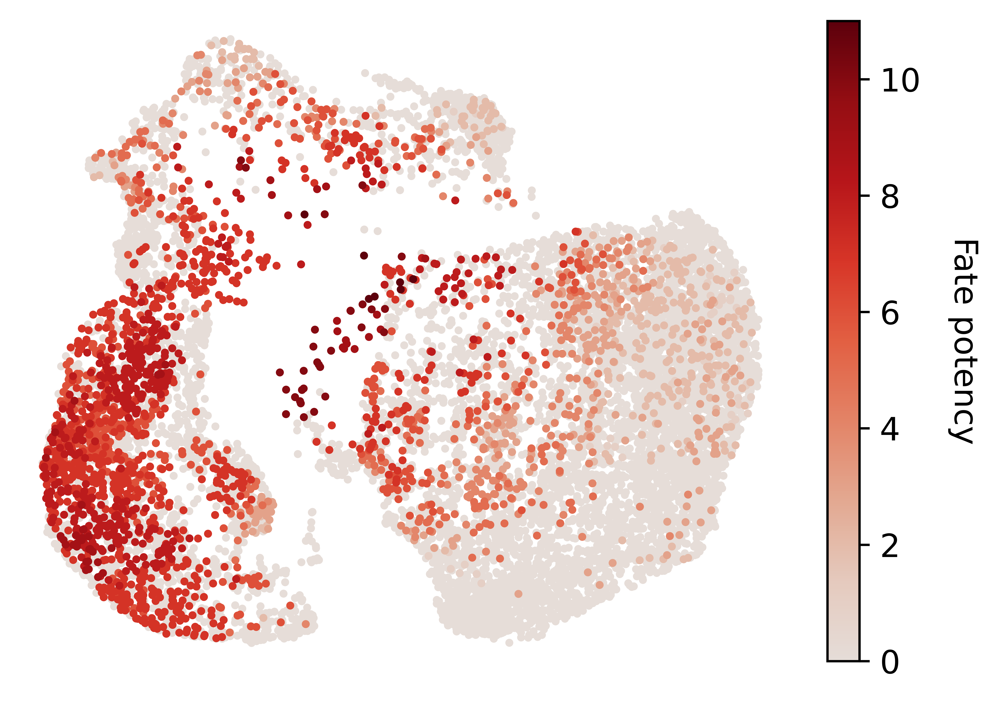

In [24]:
cs.tl.fate_potency(
    adata_all_latert,
    source="transition_map",
    map_backward=True,
    method="norm-sum",
    fate_count=True,
)

cs.pl.fate_potency(adata_all_latert, source="transition_map")

/ssd/users/mingzegao/.conda/envs/clonetrans/lib/python3.9/site-packages/cospar/tool/_utils.py:235: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  state_annote[cell_id_t2] == yy


Results saved at adata.obs['fate_map_transition_map_Monocyte']
Results saved at adata.obs['fate_map_transition_map_DC']
Results saved at adata.obs['fate_bias_transition_map_Monocyte*DC']


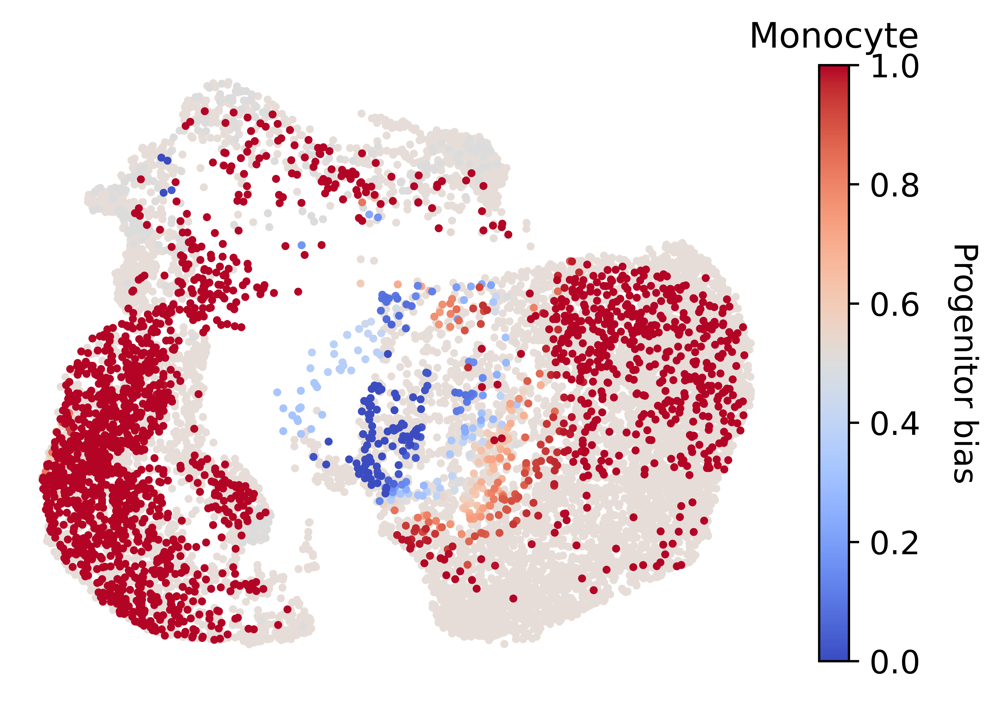

In [25]:
cs.tl.fate_bias(
    adata_all_latert,
    selected_fates=["Monocyte", "DC"],
    source="transition_map",
    pseudo_count=0,
)

cs.pl.fate_bias(
    adata_all_latert,
    selected_fates=["Monocyte", "DC"],
    source="transition_map",
    plot_target_state=False,
)

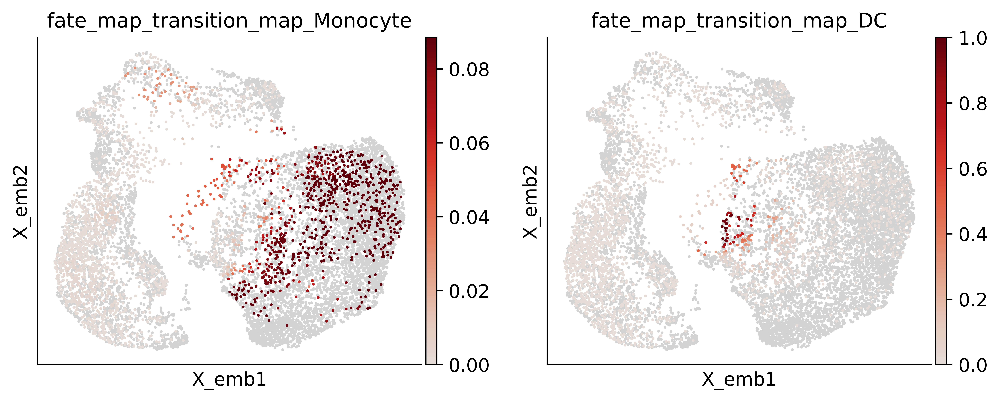

In [26]:
cs.pl.embedding(adata_all_latert, color=["fate_map_transition_map_Monocyte", "fate_map_transition_map_DC"])

/ssd/users/mingzegao/.conda/envs/clonetrans/lib/python3.9/site-packages/cospar/tool/_utils.py:235: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  state_annote[cell_id_t2] == yy


Results saved at adata.obs['fate_map_transition_map_Monocyte']
Results saved at adata.obs['fate_map_transition_map_DC']
Results saved at adata.obs['fate_bias_transition_map_Monocyte*DC']
Results saved at adata.obs[f'progenitor_transition_map_Monocyte'] and adata.obs[f'diff_trajectory_transition_map_Monocyte']
Results saved at adata.obs[f'progenitor_transition_map_DC'] and adata.obs[f'diff_trajectory_transition_map_DC']


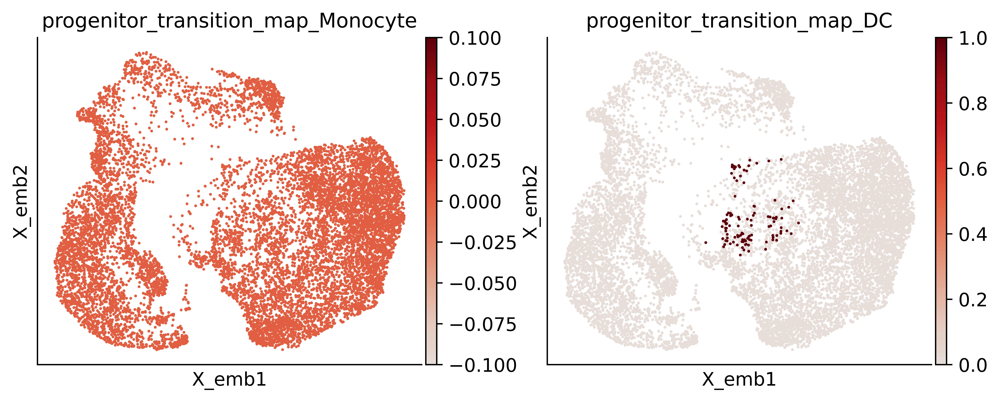

In [27]:
cs.tl.progenitor(
    adata_all_latert,
    selected_fates=["Monocyte", "DC"],
    source="transition_map",
    map_backward=True,
    bias_threshold_A=0.5,
    bias_threshold_B=0.5,
    sum_fate_prob_thresh=0.2,
    avoid_target_states=True,
)

cs.pl.embedding(adata_all_latert, color=['progenitor_transition_map_Monocyte', 'progenitor_transition_map_DC'])

In [28]:
import numpy as np

cell_group_A = np.array(adata_all_latert.obs["diff_trajectory_transition_map_Monocyte"])
cell_group_B = np.array(adata_all_latert.obs["diff_trajectory_transition_map_DC"])

dge_gene_A, dge_gene_B = cs.tl.differential_genes(
    adata_all_latert, cell_group_A=cell_group_A, cell_group_B=cell_group_B, FDR_cutoff=0.05
)

In [29]:
dge_gene_A

,index,gene,Qvalue,mean_1,mean_2,ratio
0,11,RETN,4.069293e-155,85.008232,4.816558,3.886237
1,4,S100P,3.470739e-166,14.785252,0.130872,3.803070
2,39,S100A8,5.291969e-129,408.693848,40.781319,3.293616
3,0,MNDA,1.268142e-179,28.115986,2.020767,3.268825
4,1,CSTA,5.743654e-176,14.733540,0.666624,3.238842
...,...,...,...,...,...,...
2177,5183,FANCG,5.129629e-03,0.070840,0.070739,0.000137
2178,3778,LONP2,1.675152e-04,0.234551,0.234442,0.000128
2179,5288,HIST1H2AM,6.309986e-03,0.265609,0.265518,0.000103
2180,5871,ZNF226,1.712896e-02,0.112251,0.112200,0.000066


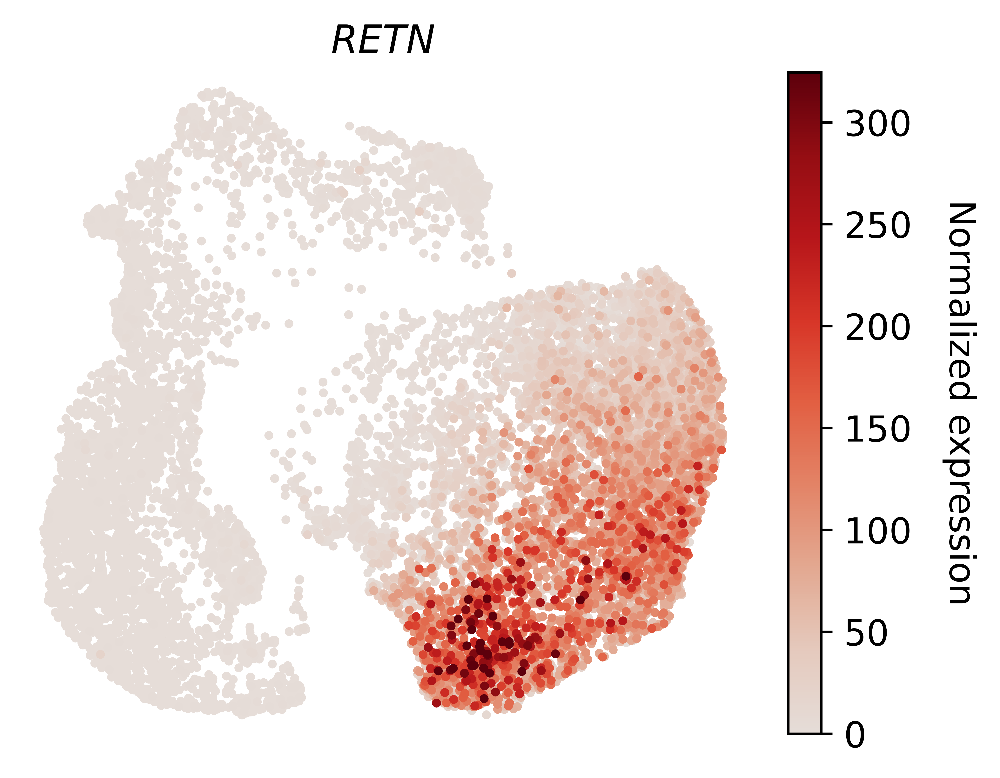

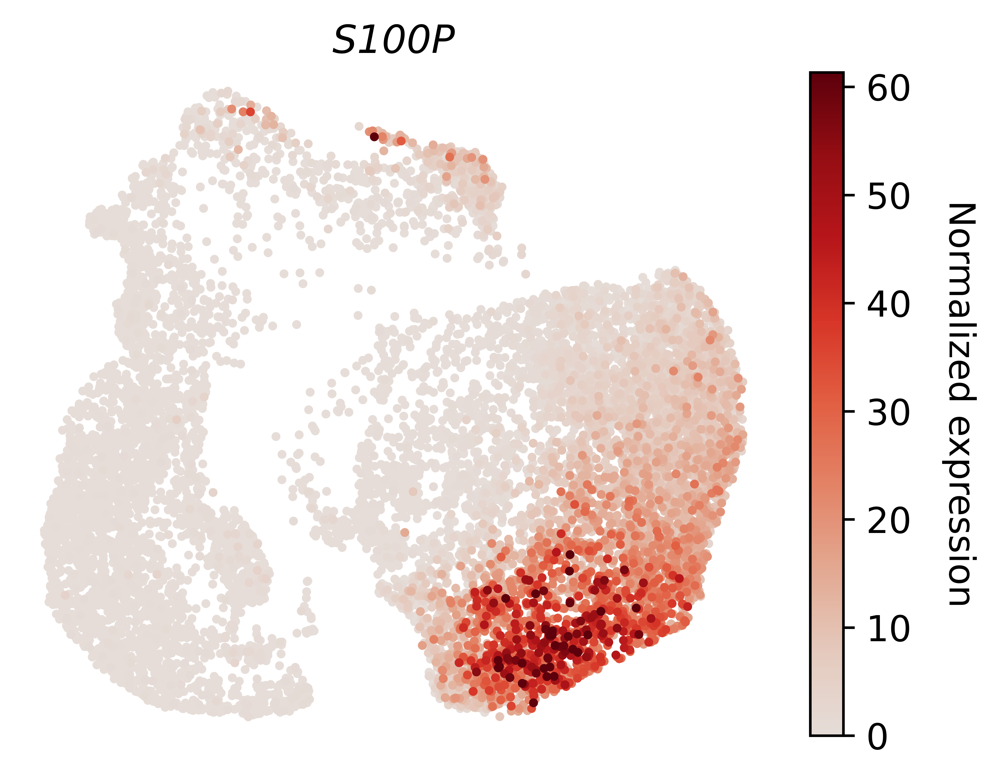

In [30]:
selected_genes = dge_gene_A["gene"][:2]
cs.pl.gene_expression_on_manifold(
    adata_all_latert, selected_genes=selected_genes, color_bar=True, savefig=False
)

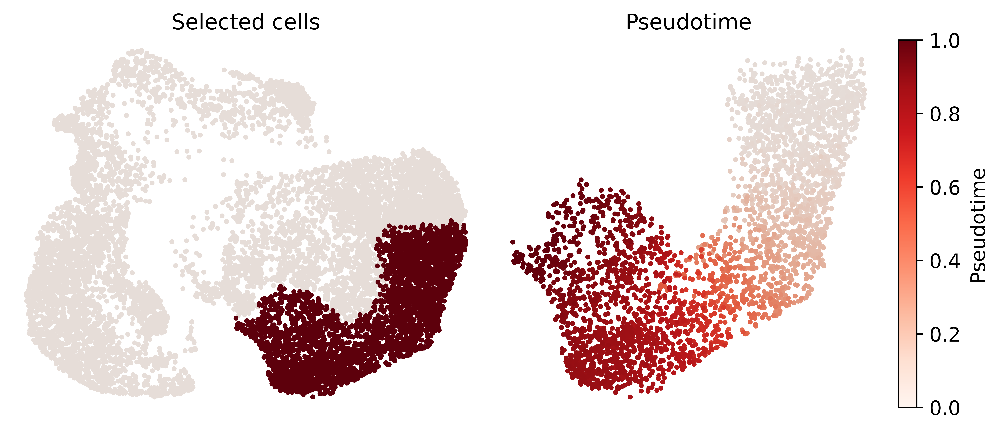

In [31]:
gene_name_list = dge_gene_A['gene'].values[:20]
selected_fate = "Monocyte"

cs.pl.gene_expression_dynamics(
    adata_all_latert,
    selected_fate,
    gene_name_list,
    traj_threshold=0.2,
    invert_PseudoTime=False,
    compute_new=True,
    gene_exp_percentile=99,
    n_neighbors=15,
    plot_raw_data=False,
)

### Benchmark with Gillespie

#### Init Gillespie Results

In [32]:
import os 
os.chdir('/ssd/users/mingzegao/clonaltrans/clonaltrans/')

path = '../trails/checkpoints/CordBloodDynamicRates/0603_121235/model_last.pt'
model = torch.load(path, map_location='cpu')
device = torch.device('cpu')

import os 
os.chdir('/ssd/users/mingzegao/clonaltrans/')

In [33]:
anno = pd.read_csv(os.path.join(
    model.config['data_loader']['args']['data_dir'], 
    model.config['data_loader']['args']['annots']
))
cluster_names = anno['populations'].values[:model.N.shape[2]]

In [34]:
gillespie_dir='./trails/checkpoints/CordBloodDynamicGillespie/0605_131252/models/'

#### Performance Comparison

In [35]:
from clonaltrans.pl import with_cospar

In [36]:
adata_all_latert.obs['meta_clones'] = adata.obs['meta_clones'].values

In [ ]:
cs.pl.embedding(adata_all_latert, color=["fate_map_transition_map_Mast cell"], save='mast.svg')

In [37]:
selected_fates = ["Late Erythroid", "Monocyte", "DC", "Mast cell"]

In [38]:
from clonaltrans.pl import with_cospar_all
with_cospar_all(
    adata_all_latert, 
    adata, 
    model, 
    cluster_names,
    gillespie_dir,
    selected_fates,
    save='benchmarkfate'
)

/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of ob

In [39]:
from clonaltrans.pl import with_cospar_all
with_cospar_all(
    adata_all_latert, 
    adata, 
    model, 
    cluster_names,
    gillespie_dir,
    selected_fates,
    show_fate=False,
    save='benchmarkprog'
)

/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of ob

In [40]:
with_cospar(
    adata_all_latert, 
    adata, 
    'MEMP', 
    'Late Erythroid', 
    model, 
    cluster_names,
    gillespie_dir,
    save='benchexamp'
)

/ssd/users/mingzegao/clonaltrans/clonaltrans/pl/benchmark.py:70: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


In [ ]:
with_cospar(
    adata_all_latert, 
    adata, 
    'HSC_MPP', 
    'Monocyte', 
    model, 
    cluster_names,
    gillespie_dir
)

In [ ]:
with_cospar(
    adata_all_latert, 
    adata, 
    'NMP', 
    'Monocyte', 
    model, 
    cluster_names,
    gillespie_dir
)

In [ ]:
with_cospar(
    adata_all_latert, 
    adata, 
    'MEMP', 
    'Late Erythroid', 
    model, 
    cluster_names,
    gillespie_dir
)